In [232]:
import pandas as pd
import scanpy as sc
import numpy as np

# Load and process data

In [3]:
meta=pd.read_csv('/datasets/Public_Datasets/BICCN/RNA-seq/macosko_lab_metadata.csv')

In [9]:
np.unique(meta[meta['region'] == 'CTX']['sub_region'].values)

array(['ANG', 'DLFC', 'MTG'], dtype=object)

In [233]:
# meta['region'].value_counts()
# meta
# !ls /datasets/Public_Datasets/BICCN/RNA-seq/macosko_10X3|wc -l
meta[meta['sub_region']=='DLFC']

,Unnamed: 0,library,species,top_region,region,sub_region,donor_id,suffix,flowcell,illumina_platform,index,transcriptome
567,578,pBICCNsMMrCTXDLFCiF021d210525A1,MM,CTX,CTX,DLFC,F021,A1,H2YFTDMXY,NovaSeq,SI-TT-A7,GRCm39.103
568,579,pBICCNsMMrCTXDLFCiF021d210525A2,MM,CTX,CTX,DLFC,F021,A2,H2YFTDMXY,NovaSeq,SI-TT-B7,GRCm39.103
573,584,pBICCNsMMrCTXDLFCiM022d210602A1,MM,CTX,CTX,DLFC,M022,A1,H2YVNDMXY,NovaSeq,SI-TT-G7,GRCm39.103
574,585,pBICCNsMMrCTXDLFCiM022d210602A2,MM,CTX,CTX,DLFC,M022,A2,H2YVNDMXY,NovaSeq,SI-TT-H7,GRCm39.103
579,590,pBICCNsMMrCTXDLFCiF022d210610A1,MM,CTX,CTX,DLFC,F022,A1,H3222DMXY,NovaSeq,SI-TT-E8,GRCm39.103
580,591,pBICCNsMMrCTXDLFCiF022d210610A2,MM,CTX,CTX,DLFC,F022,A2,H3222DMXY,NovaSeq,SI-TT-F8,GRCm39.103


In [240]:
name_v = meta[meta['sub_region']=='DLFC']['library'].values
donor_v = meta[meta['sub_region']=='DLFC']['donor_id'].values
print(name_v)
print(donor_v)

['pBICCNsMMrCTXDLFCiF021d210525A1' 'pBICCNsMMrCTXDLFCiF021d210525A2'
 'pBICCNsMMrCTXDLFCiM022d210602A1' 'pBICCNsMMrCTXDLFCiM022d210602A2'
 'pBICCNsMMrCTXDLFCiF022d210610A1' 'pBICCNsMMrCTXDLFCiF022d210610A2']
['F021' 'F021' 'M022' 'M022' 'F022' 'F022']


In [245]:
name, donor_v[x]

('pBICCNsMMrCTXDLFCiF022d210610A2', 'F022')

In [258]:
#Loop through and combine all DLFC into one dataset

adata=[]
for x,name in enumerate(name_v):
    curr_data = sc.read_10x_h5('/datasets/Public_Datasets/BICCN/RNA-seq/macosko_10X3/' + name + '_raw_feature_bc_matrix.h5')
    curr_data.var_names_make_unique() 
    curr_data.obs['sample'] = np.full(len(curr_data.obs), name)
    curr_data.obs['ID'] = np.full(len(curr_data.obs), donor_v[x])
    if x>0: 
        adata = adata.concatenate(curr_data)
    else: 
        adata=curr_data
    adata.var_names_make_unique() 
    print(curr_data.shape, name)
    print(adata.shape, curr_data.shape[0]*(x+1))

/home/dburrows/anaconda3/lib/python3.9/site-packages/anndata/_core/anndata.py:1832: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


(6794880, 21899) pBICCNsMMrCTXDLFCiF021d210525A1
(6794880, 21899) 6794880


/home/dburrows/anaconda3/lib/python3.9/site-packages/anndata/_core/anndata.py:1832: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")
/home/dburrows/anaconda3/lib/python3.9/site-packages/anndata/_core/anndata.py:1755: FutureWarning: The AnnData.concatenate method is deprecated in favour of the anndata.concat function. Please use anndata.concat instead.

See the tutorial for concat at: https://anndata.readthedocs.io/en/latest/concatenation.html
  warnings.warn(


(6794880, 21899) pBICCNsMMrCTXDLFCiF021d210525A2
(13589760, 21899) 13589760


/home/dburrows/anaconda3/lib/python3.9/site-packages/anndata/_core/anndata.py:1832: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")
/home/dburrows/anaconda3/lib/python3.9/site-packages/anndata/_core/anndata.py:1755: FutureWarning: The AnnData.concatenate method is deprecated in favour of the anndata.concat function. Please use anndata.concat instead.

See the tutorial for concat at: https://anndata.readthedocs.io/en/latest/concatenation.html
  warnings.warn(


(6794880, 21899) pBICCNsMMrCTXDLFCiM022d210602A1
(20384640, 21899) 20384640


/home/dburrows/anaconda3/lib/python3.9/site-packages/anndata/_core/anndata.py:1832: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")
/home/dburrows/anaconda3/lib/python3.9/site-packages/anndata/_core/anndata.py:1755: FutureWarning: The AnnData.concatenate method is deprecated in favour of the anndata.concat function. Please use anndata.concat instead.

See the tutorial for concat at: https://anndata.readthedocs.io/en/latest/concatenation.html
  warnings.warn(


(6794880, 21899) pBICCNsMMrCTXDLFCiM022d210602A2
(27179520, 21899) 27179520


/home/dburrows/anaconda3/lib/python3.9/site-packages/anndata/_core/anndata.py:1832: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")
/home/dburrows/anaconda3/lib/python3.9/site-packages/anndata/_core/anndata.py:1755: FutureWarning: The AnnData.concatenate method is deprecated in favour of the anndata.concat function. Please use anndata.concat instead.

See the tutorial for concat at: https://anndata.readthedocs.io/en/latest/concatenation.html
  warnings.warn(


(6794880, 21899) pBICCNsMMrCTXDLFCiF022d210610A1
(33974400, 21899) 33974400


/home/dburrows/anaconda3/lib/python3.9/site-packages/anndata/_core/anndata.py:1832: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")
/home/dburrows/anaconda3/lib/python3.9/site-packages/anndata/_core/anndata.py:1755: FutureWarning: The AnnData.concatenate method is deprecated in favour of the anndata.concat function. Please use anndata.concat instead.

See the tutorial for concat at: https://anndata.readthedocs.io/en/latest/concatenation.html
  warnings.warn(


(6794880, 21899) pBICCNsMMrCTXDLFCiF022d210610A2
(40769280, 21899) 40769280


In [259]:
#Remove low exp cells/genes
sc.pp.filter_cells(adata,min_counts=1000)
sc.pp.filter_genes(adata,min_cells=10)

#Normalise gene counts for each cell (divide by total number of counts across all genes for given cell)
sc.pp.normalize_per_cell(adata)

#Take natural log of counts + 1
sc.pp.log1p(adata)

In [260]:
adata

AnnData object with n_obs × n_vars = 58446 × 18691
    obs: 'sample', 'ID', 'batch', 'n_counts'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells'
    uns: 'log1p'

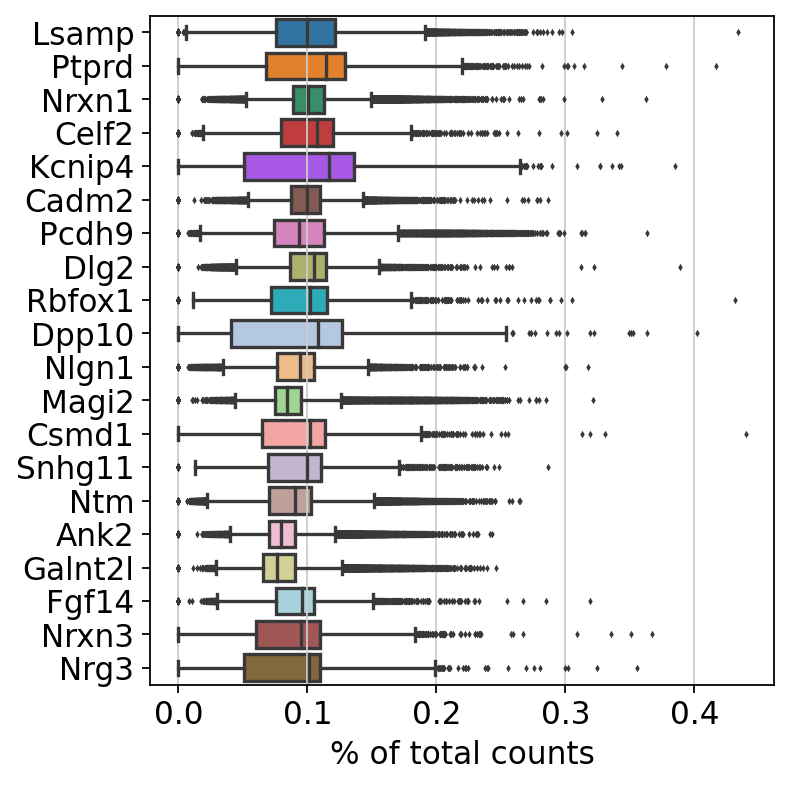

In [261]:
sc.pl.highest_expr_genes(adata, n_top=20, )

In [316]:
#Define marker genes
gaba_mark = ['Gad2', 'Gad1', 'Slc6a1', 'Slc6a13', 'Slc6a11','Slc6a12']
glu_mark = ['Slc17a7', 'Slc17a8', 'Slc17a6']

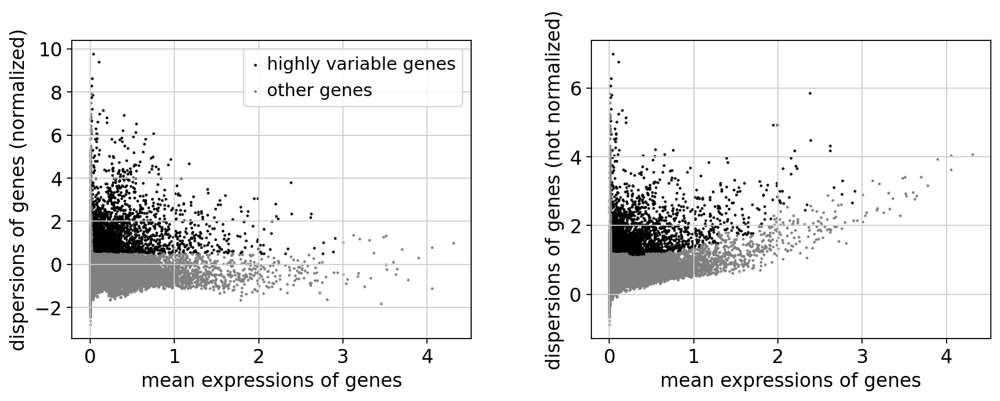

/tmp/ipykernel_189403/3240956161.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adata.var.highly_variable[i] = True


In [263]:
#Plot variable vs non variable genes
sc.pp.highly_variable_genes(adata, min_mean=0.0125, max_mean=3, min_disp=0.5)
sc.pl.highly_variable_genes(adata)

#Add in all marker genes
for i in glu_mark+gaba_mark:
    if adata.var.highly_variable[i] == False: 
        adata.var.highly_variable[i] = True

#Retain only most variable gene
var_data = adata[:,adata.var.highly_variable]

In [264]:
var_data

View of AnnData object with n_obs × n_vars = 58446 × 2911
    obs: 'sample', 'ID', 'batch', 'n_counts'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'log1p', 'hvg'

/home/dburrows/anaconda3/lib/python3.9/site-packages/scanpy/preprocessing/_simple.py:843: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


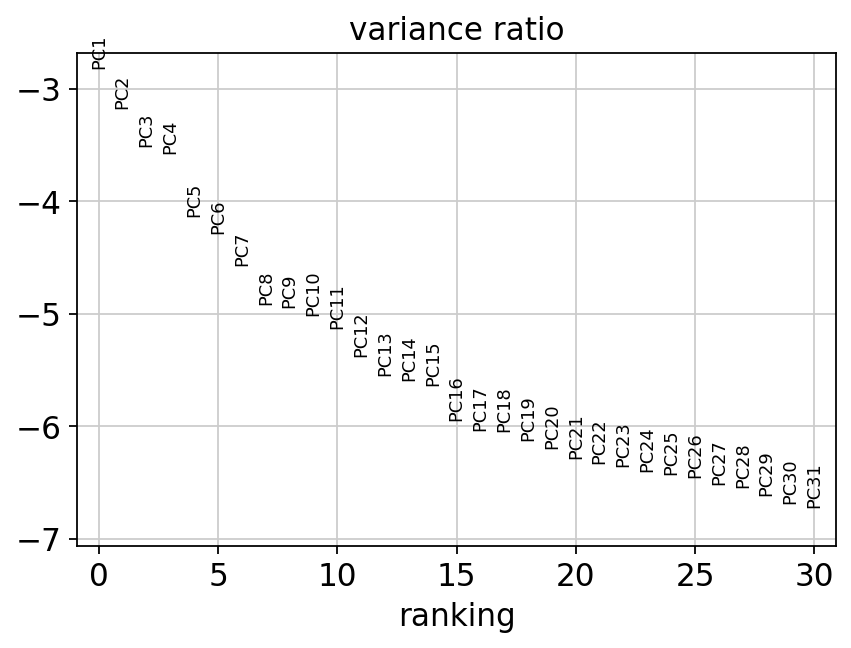

In [265]:
#PCA
sc.pp.scale(var_data, max_value=10) #scale data for PCA
sc.tl.pca(var_data, svd_solver='arpack')
sc.pl.pca_variance_ratio(var_data, log=True)
sc.set_figure_params(figsize=(6,4))

In [309]:
#UMAP embedding
sc.pp.neighbors(var_data, n_neighbors=10, n_pcs=20)
sc.tl.umap(var_data)
#Louvain clustering
sc.tl.louvain(var_data)

In [269]:
var_data

AnnData object with n_obs × n_vars = 58446 × 2911
    obs: 'sample', 'ID', 'batch', 'n_counts', 'louvain'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'log1p', 'hvg', 'pca', 'neighbors', 'umap', 'louvain', 'louvain_colors'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'distances', 'connectivities'

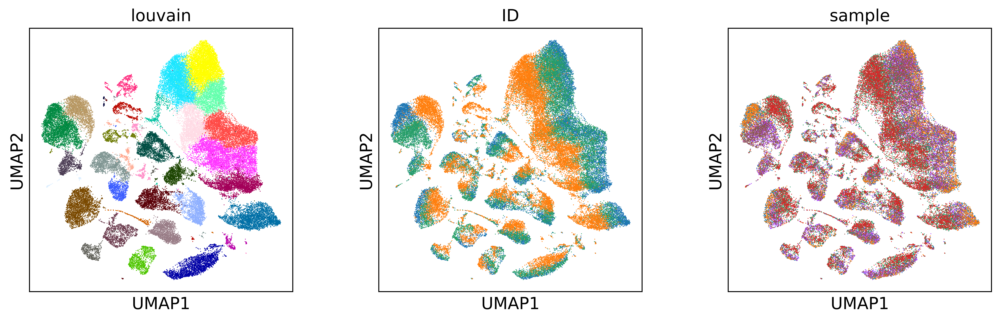

In [303]:
# UMAP by cluster, sample and donor
sc.set_figure_params(dpi=500)
sc.pl.umap(var_data,color=['louvain', 'ID', 'sample'],legend_loc='on_data')
sc.set_figure_params(figsize=(18,14))


In [317]:
print('GLU :' + str(glu_mark))
print('GABA :' + str(gaba_mark))


GLU :['Slc17a7', 'Slc17a8', 'Slc17a6']
GABA :['Gad2', 'Gad1', 'Slc6a1', 'Slc6a13', 'Slc6a11', 'Slc6a12']


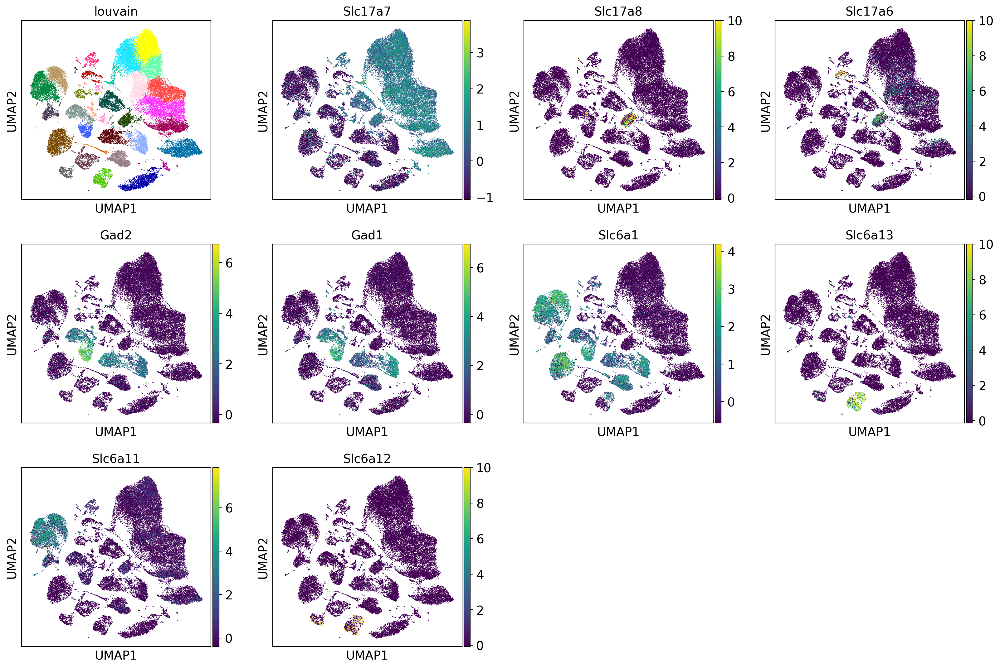

In [321]:
# UMAP by cluster, glu and gaba markers
sc.set_figure_params(dpi=100)
sc.pl.umap(var_data,color=['louvain']+glu_mark+gaba_mark, legend_loc='on_data')
sc.set_figure_params(figsize=(18,14))


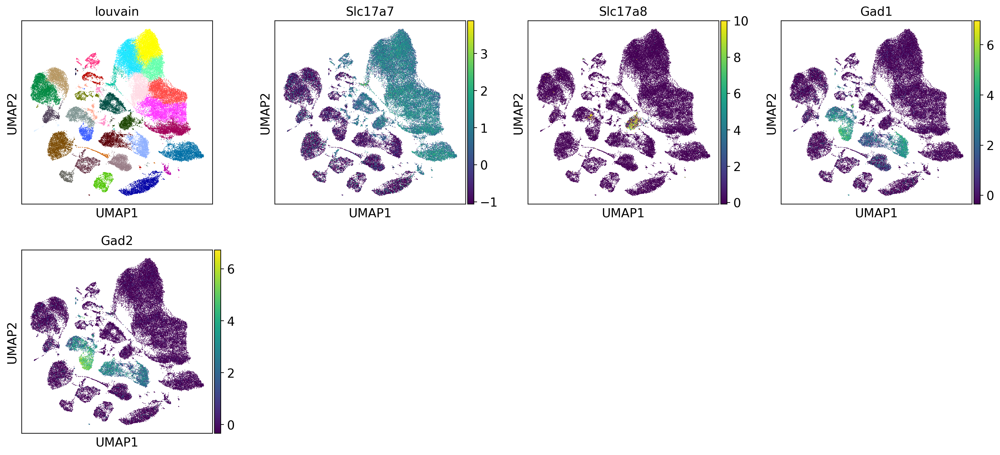

In [322]:
# UMAP by cluster, glu and gaba markers
sc.set_figure_params(dpi=100)
sc.pl.umap(var_data,color=['louvain', 'Slc17a7', 'Slc17a8','Gad1', 'Gad2'], legend_loc='on_data')
sc.set_figure_params(figsize=(18,14))


In [328]:
print('GLU :' + str(glu_mark))
print('GABA :' + str(gaba_mark))


GLU :['Slc17a7', 'Slc17a8', 'Slc17a6']
GABA :['Gad2', 'Gad1', 'Slc6a1', 'Slc6a13', 'Slc6a11', 'Slc6a12']


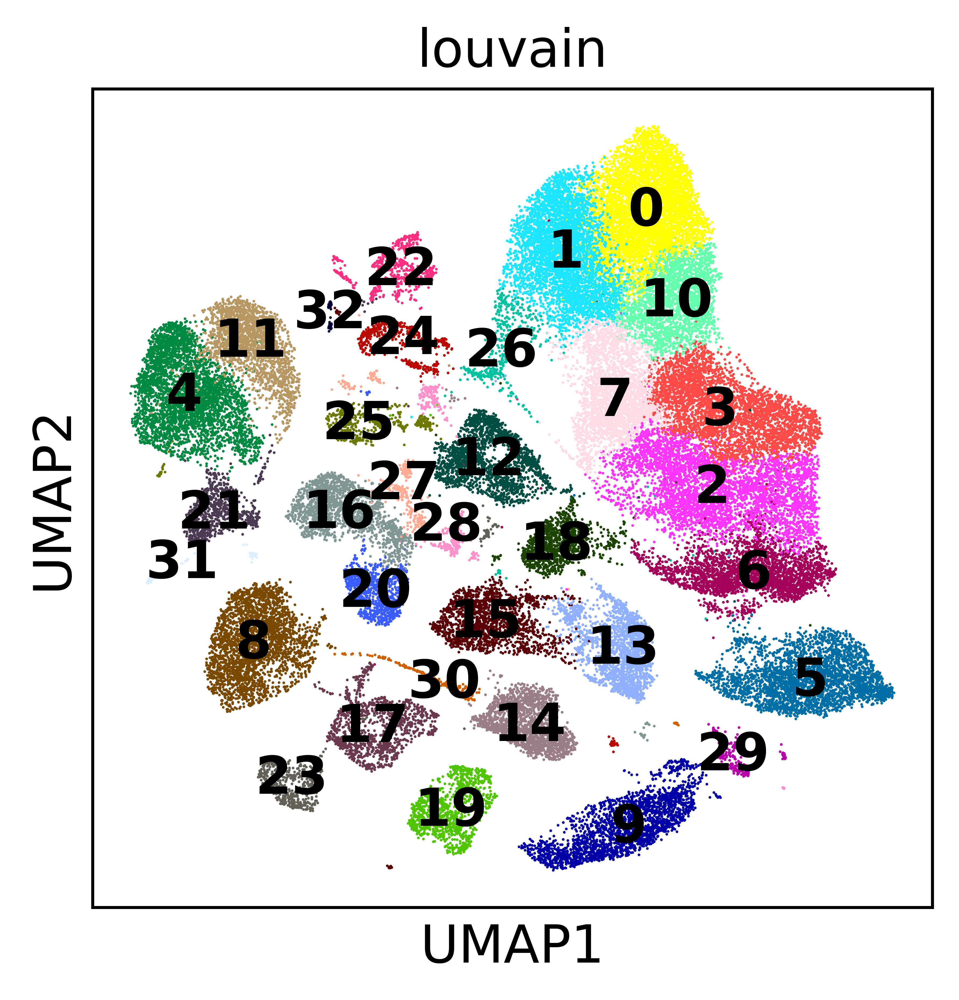

In [330]:
sc.set_figure_params(dpi=500)
sc.pl.umap(var_data,color=['louvain'],legend_loc='on data')

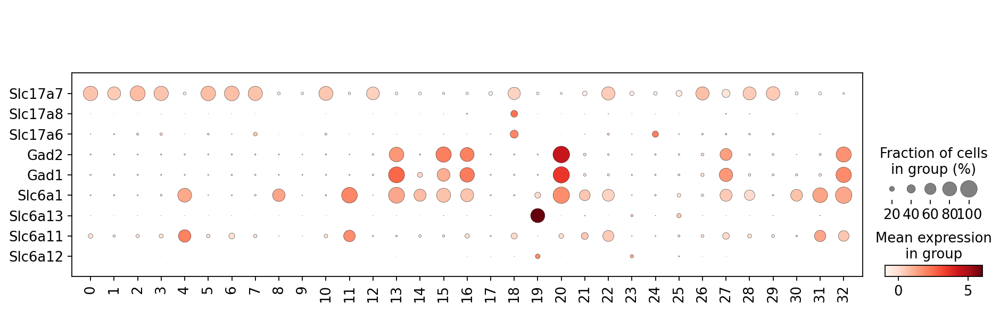

In [327]:
#Dotplot of gene expression by
sc.pl.dotplot(var_data,var_names=list(glu_mark+gaba_mark),
              groupby='louvain',swap_axes=True)

In [68]:
sc.tl.filter_rank_genes_groups(adata,groupby='louvain')

In [111]:
import numpy as np

categories: 0, 1, 2, etc.
var_group_labels: 20


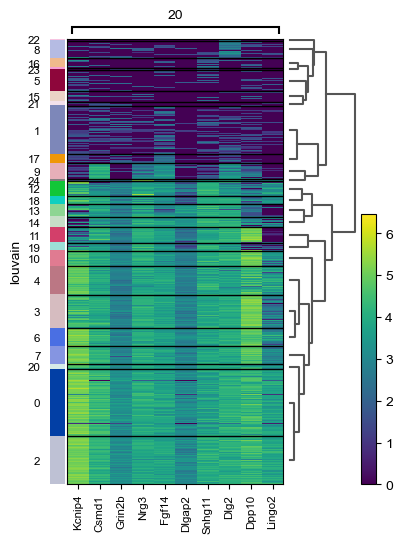

In [117]:
sc.pl.rank_genes_groups_heatmap(adata)

/home/emukamel/mambaforge/envs/analysis/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


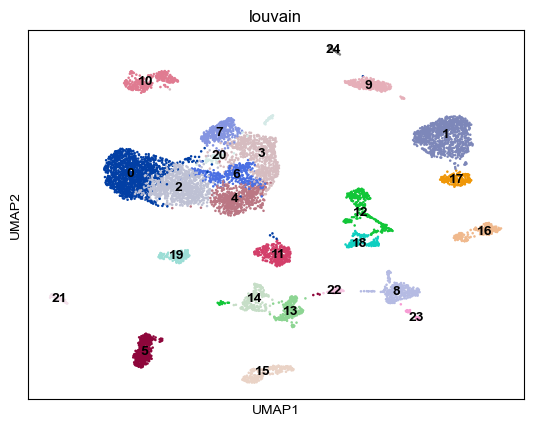

In [53]:
sc.pl.umap(adata,color=['louvain'],legend_loc='on data')